<a href="https://colab.research.google.com/github/flaaa31/Deep-Learning/blob/main/Generative_AI_project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Data Augmentation per la sicurezza delle centrali elettriche

**CyberEye Solutions**, un leader emergente nel settore della sicurezza cibernetica per infrastrutture critiche, si trova di fronte a una crescente sfida nella protezione delle centrali elettriche contro minacce informatiche avanzate. Attualmente, il sistema di sorveglianza delle centrali utilizza tecnologie di riconoscimento di immagini per identificare e reagire tempestivamente a situazioni potenzialmente pericolose. Tuttavia, la capacità di riconoscere con precisione e tempestività oggetti e comportamenti critici nelle immagini è limitata dai dataset di addestramento attualmente disponibili, che non rappresentano appieno la variabilità e la complessità delle situazioni reali.

Attualmente, i modelli esistenti basati su dataset limitati non riescono a rilevare con la necessaria precisione anomalie o minacce potenziali nelle immagini, compromettendo la capacità di risposta e mitigazione dell'azienda di fronte a situazioni di emergenza. Migliorare la capacità di identificare tempestivamente oggetti e comportamenti critici nelle immagini è fondamentale per garantire la continuità operativa e la sicurezza delle infrastrutture critiche gestite da CyberEye Solutions.

**Benefici della Soluzione**

1. **Miglioramento della Sicurezza delle Infrastrutture Critiche:** Espandere il dataset utilizzando tecniche avanzate di Data Augmentation consentirà di migliorare l'accuratezza del sistema di riconoscimento di immagini. Un modello più preciso e affidabile sarà in grado di rilevare con maggiore tempestività e precisione comportamenti sospetti o minacce potenziali nelle immagini delle centrali elettriche, migliorando così la sicurezza delle infrastrutture critiche e riducendo il rischio di incidenti o sabotaggi.
2. **Efficienza Operativa e Riduzione del Tempo di Risposta:** Automatizzando il processo di generazione di nuovi dati attraverso la creazione di immagini e testi variati, CyberEye Solutions ottimizzerà l'efficienza operativa. Questo permetterà all'azienda di concentrare le risorse umane su attività di analisi e mitigazione delle minacce, riducendo il tempo di risposta agli eventi critici e migliorando la capacità di gestione delle emergenze.
3. **Innovazione Tecnologica nel Settore della Sicurezza:** Utilizzando tecniche avanzate di deep learning e generazione di dati, CyberEye Solutions promuoverà l'innovazione nel campo della sicurezza cibernetica per infrastrutture critiche. L'implementazione di modelli di riconoscimento di immagini più sofisticati non solo migliorerà la sicurezza delle centrali elettriche, ma dimostrerà anche l'impegno dell'azienda nell'adozione di tecnologie all'avanguardia per affrontare le sfide emergenti nel settore della sicurezza cibernetica.
**Dettagli del Progetto**

* Acquisizione del Dataset: Utilizzare il dataset OxfordIIITPet da PyTorch come base per il progetto di miglioramento del sistema di riconoscimento di immagini per infrastrutture critiche.
* Image Captioning e Generazione di Dati: Applicare l’image captioning per creare descrizioni iniziali delle immagini. Successivamente, utilizzare un modello generativo di testo per produrre varianti o descrizioni analoghe. Infine, impiegare un modello generativo di immagini per creare nuove immagini a partire dalle caption originali o dai testi generati, arricchendo così il dataset con dati sintetici.
* Addestramento del Modello: Addestrare un modello di riconoscimento di immagini utilizzando il dataset esteso, valutando la qualità dei dati prodotti e confrontando le performance del modello su dataset ridotto e dataset incrementato.
* Valutazione delle Performance: Misurare l'accuracy, precision, recall e altre metriche di performance per confrontare il modello addestrato su entrambi i dataset. Commentare le differenze nelle performance e l'efficacia delle tecniche di Data Augmentation nel migliorare l'accuratezza del modello in contesti reali di sicurezza delle infrastrutture critiche.

**Conclusioni**

CyberEye Solutions si impegna a rafforzare la sicurezza delle infrastrutture critiche attraverso l'implementazione di soluzioni avanzate di riconoscimento di immagini. Utilizzando approcci innovativi e tecnologie all'avanguardia, l'azienda mira non solo a migliorare l'efficacia dei suoi sistemi di sicurezza cibernetica, ma anche a definire nuovi standard nel settore per la protezione delle infrastrutture critiche contro le minacce informatiche sempre più sofisticate.



In [ ]:
# Libraries installation
! pip install torch torchvision transformers pillow matplotlib tqdm scikit-learn diffusers accelerate pandas


[notice] A new release of pip is available: 25.0.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


# Importing libraries and initial setup

In [ ]:
import os
import torch
import matplotlib.pyplot as plt
import numpy as np
from tqdm.notebook import tqdm
import random
from PIL import Image
import pandas as pd
from transformers import BlipProcessor, BlipForConditionalGeneration
import re
import torch.nn as nn
import torch.optim as optim
from collections import Counter
from diffusers import StableDiffusionPipeline
import gc
import json
from sklearn.metrics import confusion_matrix, f1_score
from collections import Counter
import seaborn as sns
import PIL
from torch.utils.data import DataLoader, Dataset, Subset, ConcatDataset
import torchvision.transforms as T
from torchvision import datasets
from sklearn.metrics import f1_score
import timm
from torch.optim.lr_scheduler import ReduceLROnPlateau
import glob
import time
from datetime import datetime
from timm import create_model
from PIL import Image, ImageOps
import torch
import math
from scipy import linalg
import torchvision

In [ ]:
# files and folder names where everything will be saved
captions_file = "image_captions.csv"
cleaned_captions_file = "image_captions_cleaned.csv"
generated_captions_raw = "generated_captions_raw.csv"
generated_captions_cleaned = "generated_captions_cleaned.csv"
generated_images_folder = "generated_pet_images"

In [ ]:
# Check GPU availability
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Device: {device}")

Device: cuda


In [ ]:
# training already done
do_train = False

In [ ]:
# Common transform: resize to 224×224 and convert to tensor
common_transform = T.Compose([
    T.Resize((224, 224)),
    T.ToTensor(),
])


# Dataset download (OxfordIIITPet)
dataset_path = './oxford_pet'
os.makedirs(dataset_path, exist_ok=True)

# Train-validation split combined (we don't need validation dataset for now)
train_dataset = datasets.OxfordIIITPet(
    root=dataset_path,
    split='trainval',
    download=True,
    transform=common_transform
)

# Test dataset
test_dataset = datasets.OxfordIIITPet(
    root=dataset_path,
    split='test',
    download=True,
    transform=T.Compose([
        T.Resize((224, 224)),
        T.ToTensor()
    ])
)

# Standard batch size
batch_size = 32

# DataLoader creation
train_loader = torch.utils.data.DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True
)
test_loader = torch.utils.data.DataLoader(
    test_dataset,
    batch_size=batch_size
)

# EDA

In [ ]:

# Dataset classes
classes = train_dataset.classes

# Print dataset statistics
print(f"Number of classes: {len(classes)}")
print(f"Number of images in training set: {len(train_dataset)}")
print(f"Number of images in test set: {len(test_dataset)}")

def count_examples_per_class(dataset):
  """
  Print the number of images for each class.

  Parameters:
  dataset (torchvision.datasets.OxfordIIITPet): The dataset.

  """
  # label extraction from dataset
  labels = [dataset[i][1] for i in range(len(dataset))]

  # Counts every image of each label
  counts = Counter(labels)

  # print class name and number of images
  for class_idx, num in counts.items():
      print(f"{classes[class_idx]}: {num}")

print("\nNumber of images per class \n")
print("TRAINVAL SET: \n")
count_examples_per_class(train_dataset)
print("-" * 50)
print("TEST SET: \n")
count_examples_per_class(train_dataset)

Number of classes: 37
Number of images in training set: 3680
Number of images in test set: 3669

Number of images per class 

TRAINVAL SET: 

Abyssinian: 100
American Bulldog: 100
American Pit Bull Terrier: 100
Basset Hound: 100
Beagle: 100
Bengal: 100
Birman: 100
Bombay: 96
Boxer: 100
British Shorthair: 100
Chihuahua: 100
Egyptian Mau: 93
English Cocker Spaniel: 96
English Setter: 100
German Shorthaired: 100
Great Pyrenees: 100
Havanese: 100
Japanese Chin: 100
Keeshond: 100
Leonberger: 100
Maine Coon: 100
Miniature Pinscher: 100
Newfoundland: 96
Persian: 100
Pomeranian: 100
Pug: 100
Ragdoll: 100
Russian Blue: 100
Saint Bernard: 100
Samoyed: 100
Scottish Terrier: 100
Shiba Inu: 100
Siamese: 99
Sphynx: 100
Staffordshire Bull Terrier: 100
Wheaten Terrier: 100
Yorkshire Terrier: 100
--------------------------------------------------
TEST SET: 

Abyssinian: 100
American Bulldog: 100
American Pit Bull Terrier: 100
Basset Hound: 100
Beagle: 100
Bengal: 100
Birman: 100
Bombay: 96
Boxer: 100
B

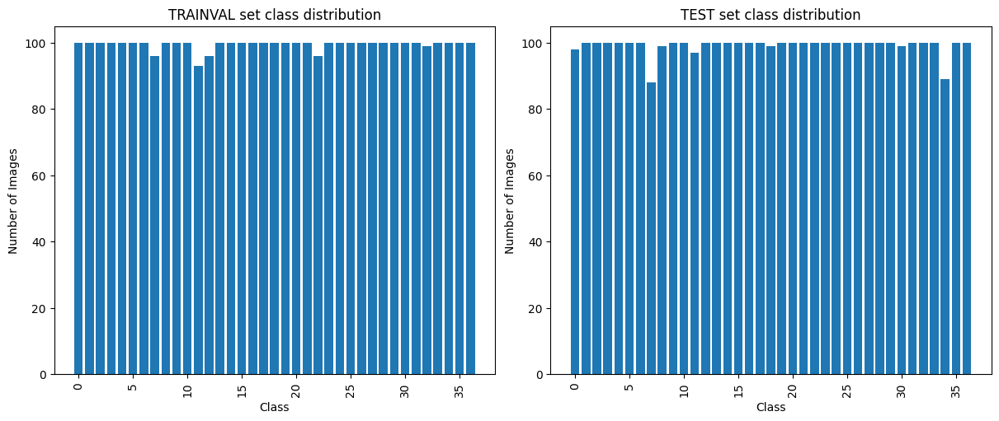

In [ ]:

def plot_class_distribution(ax, dataset):
    """
    Plot the class distribution of the dataset onto the given Axes.

    Parameters:
    ax : matplotlib.axes.Axes
        The axes to draw the bar chart on.
    dataset : torchvision.datasets.OxfordIIITPet
        The dataset to analyze.
    """
    # Extract labels for every sample
    labels = [dataset[i][1] for i in range(len(dataset))]
    counts = Counter(labels)
    classes = sorted(counts.keys())

    # Draw bar chart on provided axes
    ax.bar(classes, [counts[c] for c in classes])
    ax.set_xlabel('Class')
    ax.set_ylabel('Number of Images')
    ax.set_title(f"{dataset._split.upper()} set class distribution")
    ax.tick_params(axis='x', rotation=90)


# Create trainval and test plots
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12, 5), constrained_layout=True)
plot_class_distribution(ax1, train_dataset)
plot_class_distribution(ax2, test_dataset)

plt.show()

the dataset is pretty **balanced**, both in train and test set, so we don't need to be worried about some underrepresented classes

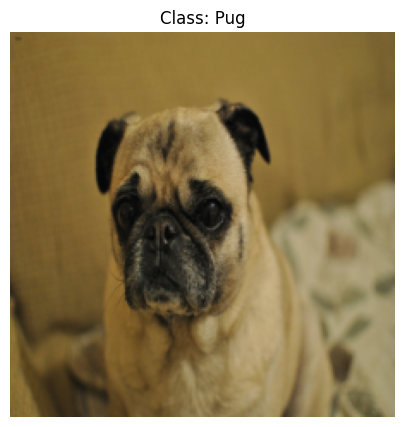

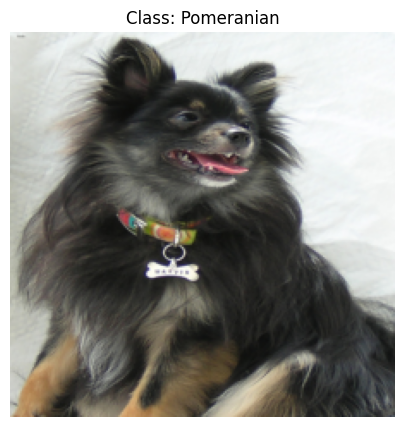

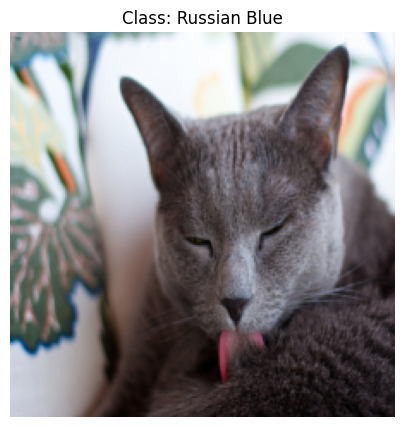

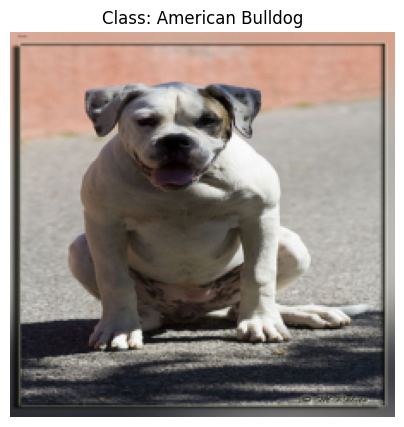

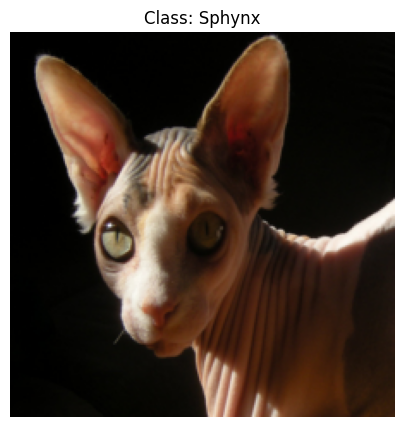

In [ ]:
# Visualization of some dataset images
def imshow(img, title):
    """
    Display a single image tensor.

    Parameters:

    img : torch.Tensor
        The image tensor of shape (C, H, W) to display.
    title : str, optional
        Optional title to display above the image.
    """
    # Convert from (C, H, W) to (H, W, C) and to NumPy array
    img_np = img.permute(1, 2, 0).numpy()
    plt.figure(figsize=(5, 5))
    plt.imshow(img_np)
    if title:
        plt.title(title)
    plt.axis('off')
    plt.show()

# Show 5 random example images from the training set
for i in range(5):
    idx = random.randint(0, len(train_dataset) - 1)
    img, label = train_dataset[idx]
    class_name = classes[label]
    imshow(img, title=f'Class: {class_name}')



# Blip image captioning
We use blip-image-captioning-base model to generate captions of our images

Captions already generated in file: image_captions.csv

Random examples of images with their captions:


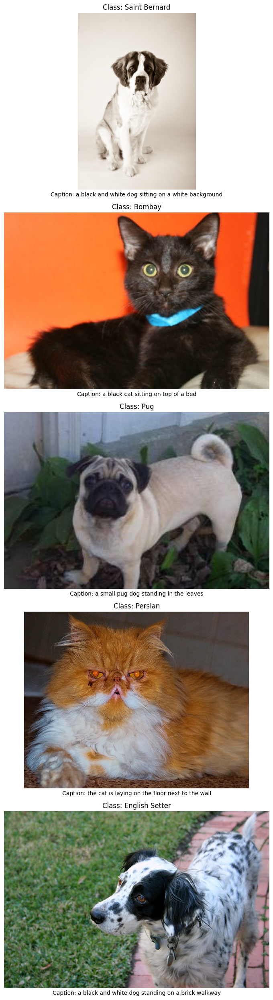

In [ ]:
if os.path.exists(captions_file):
    print(f"Captions already generated in file: {captions_file}")
    # Load existing captions
    captions_df = pd.read_csv(captions_file)

    # Load the dataset without transformations to access raw PIL images
    dataset_path = './oxford_pet'
    train_dataset = datasets.OxfordIIITPet(
        root=dataset_path,
        split='trainval',
        download=False,
        transform=None
    )


else:
    print("No existing captions file found. Generating captions...")

    # Load BLIP model and processor from Hugging Face
    processor = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
    model = BlipForConditionalGeneration.from_pretrained(
        "Salesforce/blip-image-captioning-base"
    ).to(device)

    model.eval()

    def generate_caption(image):
        """
        Generate a caption for a given PIL image using BLIP.

        Parameters:
        image : PIL.Image.Image
            The input image for which to generate a caption.

        Returns
        str
            The generated caption text.
        """
        # Preprocess image into model inputs
        inputs = processor(images=image, return_tensors="pt").to(device)

        with torch.no_grad():
            # Generate caption tokens
            output_ids = model.generate(
                **inputs,
                max_length=30,
                min_length=10,
                num_beams=3
            )
            # Decode tokens to text
            caption = processor.decode(output_ids[0], skip_special_tokens=True)

        # clear GPU memory
        del inputs
        torch.cuda.empty_cache()

        return caption

    # Load dataset without transformations to access raw PIL images
    dataset_path = './oxford_pet'
    train_dataset = datasets.OxfordIIITPet(
        root=dataset_path,
        split='trainval',
        download=False,
        transform=None
    )

    # Generate captions for each image in the dataset
    captions_data = []
    for i in tqdm(range(len(train_dataset))):
        img, label = train_dataset[i]
        class_name = train_dataset.classes[label]

        # Generate caption from PIL image
        caption = generate_caption(img)

        captions_data.append({
            'image_id': i,
            'class': class_name,
            'caption': caption
        })

        # Remove image from memory
        del img

    # Create DataFrame and save to CSV
    captions_df = pd.DataFrame(captions_data)
    captions_df.to_csv(captions_file, index=False)
    print(f"Generated {len(captions_df)} captions and saved to {captions_file}")

# Display 5 random images with their captions
print("\nRandom examples of images with their captions:")
num_examples = 5
total_images = len(captions_df)
random_indices = random.sample(range(total_images), min(num_examples, total_images))

fig, axes = plt.subplots(num_examples, 1, figsize=(10, 5 * num_examples))

for i, idx in enumerate(random_indices):
    # Retrieve image from the dataset
    img, _ = train_dataset[captions_df.iloc[idx]['image_id']]

    # Fetch class name and caption
    class_name = captions_df.iloc[idx]['class']
    caption = captions_df.iloc[idx]['caption']

    ax = axes[i] if num_examples > 1 else axes
    ax.imshow(img)
    ax.set_title(f"Class: {class_name}", fontsize=12)
    ax.set_xlabel(f"Caption: {caption}", fontsize=10)

    # ticks removal
    ax.set_xticks([])
    ax.set_yticks([])

    # spines removal
    for spine in ax.spines.values():
        spine.set_visible(False)

plt.tight_layout()
plt.show()


## Captions cleaning
<a name="cap-cleaning">

some captions don't make that much sense, so we filter the captions file removing the ones that don't have our main subjects (cat or dog) and we remove captions that have more than 2 repeated words


In [ ]:

if os.path.exists(cleaned_captions_file):
    print(f"Captions already cleaned in file: {cleaned_captions_file}")

else:
    print("No existing cleaned captions file found. Cleaning captions...")

    # Load original captions dataset
    captions_df = pd.read_csv("image_captions.csv")
    print(f"\nOriginal dataset size: {len(captions_df)} rows")

    def contains_keywords(caption):
        """
        Check if the caption contains at least one of the target keywords.

        Parameters:

        caption : str
            The text of the caption to check.

        Returns

        bool
            True if any keyword is present in the caption, False otherwise.
        """
        keywords = ['cat', 'dog']
        caption_lower = caption.lower()
        return any(keyword in caption_lower for keyword in keywords)

    def has_repeated_words(caption):
        """
        Determine if the caption contains two or more occurrences of any significant word,
        ignoring punctuation and common stopwords.

        Parameters:

        caption : str
            The text of the caption to analyze.

        Returns
        bool
            True if any word (excluding stopwords) appears at least twice, False otherwise.
        """
        # Remove punctuation and convert to lowercase
        clean_caption = re.sub(r'[^\w\s]', '', caption.lower())

        # Define stopwords to ignore in repetition count
        ignore_words = {
            'a', 'an', 'the', 'in', 'on', 'at', 'of', 'with',
            'and', 'or', 'to', 'is'
        }

        # Count word occurrences
        words = clean_caption.split()
        word_counts = {}
        for word in words:
            if word not in ignore_words:
                word_counts[word] = word_counts.get(word, 0) + 1

        # Check if any word occurs twice or more
        return any(count >= 2 for count in word_counts.values())

    # Identify captions without target keywords
    removed_by_keyword = captions_df[~captions_df['caption'].apply(contains_keywords)].copy()

    # Filter captions that include keywords
    filtered_df = captions_df[captions_df['caption'].apply(contains_keywords)]
    print(f"Dataset size after keyword filtering: {len(filtered_df)} rows")

    # Identify captions with repeated words among filtered set
    removed_by_repetition = filtered_df[filtered_df['caption'].apply(has_repeated_words)].copy()

    # Exclude captions that have repeated words
    final_df = filtered_df[~filtered_df['caption'].apply(has_repeated_words)]
    print(f"Dataset size after removing repeated words: {len(final_df)} rows")

    # Save the cleaned dataset
    final_df.to_csv(cleaned_captions_file, index=False)
    print(f"\nCleaned dataset saved as '{cleaned_captions_file}'")


    # Display examples removed due to missing keywords
    print("Examples of captions removed (missing keywords 'cat' or 'dog'):")
    for i in range(min(2, len(removed_by_keyword))):
        print(f"Class: {removed_by_keyword.iloc[i]['class']}")
        print(f"Caption: {removed_by_keyword.iloc[i]['caption']}\n")

    # Display examples removed due to repeated words
    print("Examples of captions removed (contains repeated words):")
    for i in range(min(2, len(removed_by_repetition))):
        print(f"Class: {removed_by_repetition.iloc[i]['class']}")
        print(f"Caption: {removed_by_repetition.iloc[i]['caption']}")
        # Highlight repeated words
        clean_caption = re.sub(r'[^\w\s]', '', removed_by_repetition.iloc[i]['caption'].lower())
        words = clean_caption.split()
        word_counts = {}
        for word in words:
            if word not in {'a', 'an', 'the', 'in', 'on', 'at', 'of', 'with', 'and', 'or', 'to', 'is'}:
                word_counts[word] = word_counts.get(word, 0) + 1
        repeated_words = [w for w, count in word_counts.items() if count >= 2]
        print(f"Repeated words: {', '.join(repeated_words)}\n")


Captions already cleaned in file: image_captions_cleaned.csv


# Alternative caption generation
We use a simple RNN to generate alternative camptions, starting from the ones that we already have


In [ ]:
if os.path.exists(generated_captions_raw):
        print(f"Alternative captions already generated in file: {generated_captions_raw}")

else:
    print("No existing captions generated file found. Generating alternative captions...")


    # Caption extraction and trasformation to list
    captions_df = pd.read_csv("image_captions_cleaned.csv")
    captions = captions_df['caption'].tolist()


    # Vocab creation
    word_counts = Counter()
    for caption in captions:
        word_counts.update(caption.split())

    # Filtering words with low frequency (less than 2)
    min_word_count = 2
    filtered_words = {word: count for word, count in word_counts.items() if count >= min_word_count}

    # Adding special tokens and creating mapping
    vocab = ['<PAD>', '<UNK>', '<START>', '<END>'] + list(filtered_words.keys())
    word_to_idx = {word: idx for idx, word in enumerate(vocab)}
    idx_to_word = {idx: word for word, idx in word_to_idx.items()}

    print(f"Vocabulary dimension: {len(vocab)} words")

    # Data preparation for training
    def caption_to_indices(caption, max_length=20):
        """
        Convert a caption string into a list of token indices, with padding and special tokens.

        Parameters:

        caption (str): The input caption to tokenize.
        max_length (int, optional): Maximum sequence length (including start/end tokens). Defaults to 20.

        Returns

        List[int]: A list of token indices of length `max_length`.
        """
        words = caption.split()
        indices = [word_to_idx.get(word, word_to_idx['<UNK>']) for word in words]

        # Adding START and END tokens
        indices = [word_to_idx['<START>']] + indices + [word_to_idx['<END>']]

        # Padding or truncation
        if len(indices) < max_length:
            indices = indices + [word_to_idx['<PAD>']] * (max_length - len(indices))
        else:
            indices = indices[:max_length]

        return indices

    # Dataset
    class CaptionDataset(Dataset):
        """
        PyTorch Dataset for image captions. Converts captions into input-target pairs of indices.

        Parameters:

        captions (List[str]): List of caption strings.
        max_length (int): Maximum token sequence length.
        """
        def __init__(self, captions, max_length=20):
            """
            Initialize the CaptionDataset.

            Parameters:

            captions (List[str]): List of cleaned caption strings.
            max_length (int, optional): Maximum sequence length. Defaults to 20.
            """
            self.captions = captions
            self.max_length = max_length

        def __len__(self):
            """Return the number of captions."""
            return len(self.captions)

        def __getitem__(self, idx):
            """
            Get a tokenized caption pair for training.

            Parameters:

            idx (int): Index of the caption.

            Returns
            Tuple[torch.Tensor, torch.Tensor]: (input_sequence, target_sequence)
            """
            caption = self.captions[idx]
            indices = caption_to_indices(caption, self.max_length)

            # Input and target creation
            input_seq = indices[:-1]  # Everything but the last token
            target_seq = indices[1:]  # Everything but the first token

            return torch.tensor(input_seq), torch.tensor(target_seq)

    # RNN model definition
    class CaptionGenerator(nn.Module):
        """
        LSTM-based neural network for generating image captions.

        Parameters:

            vocab_size (int): Size of the vocabulary.
            embed_size (int, optional): Dimensionality of word embeddings. Defaults to 256.
            hidden_size (int, optional): Dimensionality of LSTM hidden state. Defaults to 512.
            num_layers (int, optional): Number of stacked LSTM layers. Defaults to 2.
            dropout (float, optional): Dropout probability. Defaults to 0.5.
        """
        def __init__(self, vocab_size, embed_size=256, hidden_size=512, num_layers=2, dropout=0.5):
            super(CaptionGenerator, self).__init__()
            self.embedding = nn.Embedding(vocab_size, embed_size)
            self.lstm = nn.LSTM(embed_size, hidden_size, num_layers, batch_first=True, dropout=dropout)
            self.fc = nn.Linear(hidden_size, vocab_size)
            self.dropout = nn.Dropout(dropout)
            self.hidden_size = hidden_size
            self.num_layers = num_layers

        def forward(self, x):
            """
            Forward pass through the network.

            Parameters:

                x (torch.Tensor): Input tensor of shape (batch_size, seq_length).

            Returns
                torch.Tensor: Output logits of shape (batch_size, seq_length, vocab_size).
            """
            embeds = self.dropout(self.embedding(x))  # (batch_size, sequence_length, embed_size)
            lstm_out, _ = self.lstm(embeds)  # (batch_size, sequence_length, hidden_size)
            output = self.fc(lstm_out)  # (batch_size, sequence_length, vocab_size)
            return output

        def generate_caption(self, max_length=20, temperature=1.0):
            """
            Generates a caption by sampling tokens iteratively.

            Parameters:

                max_length (int, optional): Max length of generated caption. Defaults to 20.
                temperature (float, optional): Sampling temperature for diversity. Defaults to 1.0.

            Returns
                str: Generated caption string (without start/end tokens).
            """
            # START TOKEN initialization
            device = next(self.parameters()).device  # moving to device
            input_seq = torch.tensor([word_to_idx['<START>']]).to(device)
            caption = []

            with torch.no_grad():
                for _ in range(max_length):
                    # Forward pass
                    embeds = self.embedding(input_seq).unsqueeze(0)  # Adding batch dimension
                    lstm_out, _ = self.lstm(embeds)
                    output = self.fc(lstm_out[:, -1, :])  # only last output

                    # temperature
                    output = output / temperature

                    # Sampling from vocabulary
                    probs = torch.softmax(output, dim=-1)
                    next_word_idx = torch.multinomial(probs, 1).item()

                    # Stop if next word is END or PAD
                    if next_word_idx == word_to_idx['<END>'] or next_word_idx == word_to_idx['<PAD>']:
                        break

                    # Adding word to caption and update input
                    word = idx_to_word[next_word_idx]
                    caption.append(word)
                    input_seq = torch.cat([input_seq, torch.tensor([next_word_idx]).to(device)], dim=0)

            return ' '.join(caption)

    # dataset and dataloader creation
    max_length = 20
    dataset = CaptionDataset(captions, max_length=max_length)
    dataloader = DataLoader(dataset, batch_size=64, shuffle=True)

    # Model inizialization
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    vocab_size = len(vocab)
    model = CaptionGenerator(vocab_size).to(device)

    # Loss and optimizer
    criterion = nn.CrossEntropyLoss(ignore_index=word_to_idx['<PAD>'])
    optimizer = optim.Adam(model.parameters(), lr=0.001)

    # Training loop
    num_epochs = 30
    print(f"Inizio training del modello su {device}...")

    for epoch in range(num_epochs):
        model.train()
        total_loss = 0

        for inputs, targets in tqdm(dataloader, desc=f"Epoch {epoch+1}/{num_epochs}"):
            inputs, targets = inputs.to(device), targets.to(device)

            # Forward pass
            outputs = model(inputs)

            # Compute loss
            loss = criterion(outputs.reshape(-1, vocab_size), targets.reshape(-1))

            # Backward pass and optimization
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            total_loss += loss.item()

        avg_loss = total_loss / len(dataloader)
        print(f"Epoch {epoch+1}/{num_epochs}, Loss: {avg_loss:.4f}")

        # Some examples
        if (epoch + 1) % 5 == 0:
            model.eval()
            print("Captions generated examples:")
            for _ in range(3):
                caption = model.generate_caption(temperature=0.8)
                print(f"  - {caption}")

    print("Training completed!")

    # New captions generation
    model.eval()
    num_captions_to_generate = 500
    temperatures = [0.7, 0.8, 0.9, 1.0, 1.1]  # Different temperatures to increase variation

    print(f"Generation of {num_captions_to_generate} new captions...")
    generated_captions = []

    for _ in tqdm(range(num_captions_to_generate)):
        # Random temperature between temperatures list
        temperature = random.choice(temperatures)
        caption = model.generate_caption(temperature=temperature)
        generated_captions.append(caption)

    # New dataframe with generated captions
    generated_df = pd.DataFrame({'caption': generated_captions})
    generated_df.to_csv('./generated_captions_raw.csv', index=False)

    print(f"Alternative captions generated in file: {generated_captions_raw}")



Alternative captions already generated in file: generated_captions_raw.csv


## Same captions cleaning as the one that has been done before [here](#cap-cleaning)

In [ ]:
# Cleaning of generated captions
if os.path.exists(generated_captions_cleaned):
        print(f"Alternative captions already cleaned in file: {generated_captions_cleaned}")

else:
    print("No existing captions cleaned file found. Cleaning alternative captions...")

    # Cleaning functions already used for cleaning initial captions
    def contains_keywords(caption):
        """
        Check if the given caption contains any of the specified keywords.

        This function performs a case-insensitive search for each keyword
        in the `keywords` list within the provided caption string.

        Parameters:

        caption (str): The text caption to search.

        Returns:

        bool: True if at least one keyword is found in the caption;
              False otherwise.
        """
        keywords = ['cat', 'dog']
        caption_lower = caption.lower()
        return any(keyword in caption_lower for keyword in keywords)

    def has_repeated_words(caption):
        """
        Determine whether the caption has any repeated non-trivial words.

        This function normalizes the caption by removing all punctuation,
        converting to lowercase, and splitting into words. It ignores
        a set of common stop-words. If any remaining word appears two
        or more times, the function returns True.

        Parameters:

        caption (str): The text caption to analyze.

        Returns:

        bool: True if any non-stop-word appears at least twice;
              False otherwise.
        """
        clean_caption = re.sub(r'[^\w\s]', '', caption.lower())
        ignore_words = {'a', 'an', 'the', 'in', 'on', 'at', 'of', 'with', 'and', 'or', 'to', 'is'}

        words = clean_caption.split()
        word_counts = {}

        for word in words:
            if word not in ignore_words:
                if word in word_counts:
                    word_counts[word] += 1
                else:
                    word_counts[word] = 1


        return any(count >= 2 for count in word_counts.values())

    # 3. Removing captions containing "UNK"
    def contains_unk(caption):
        """
        Check if the caption contains the token 'UNK'.

        Performs a case-insensitive search for the substring
        'unk' within the provided caption string.

        Parameters:

        caption (str): The text caption to check.

        Returns:

        bool: True if 'unk' appears anywhere in the caption;
            False otherwise.
        """
        return 'unk' in caption.lower()

    # Starting cleaning
    print("Generated captions cleaning...")

    # 1. Only captions with keywords
    filtered_df = generated_df[generated_df['caption'].apply(contains_keywords)]
    print(f"Dataset dimension after keywords filtering: {len(filtered_df)} captions")

    # 2. Only captions without two or more repeated words
    filtered_df = filtered_df[~filtered_df['caption'].apply(has_repeated_words)]
    print(f"Dataset dimension after repeated words removal: {len(filtered_df)} captions")

    final_df = filtered_df[~filtered_df['caption'].apply(contains_unk)]
    print(f"Dataset dimension after 'UNK' removal: {len(final_df)} captions")

    # Dataset cleaned saving
    final_df.to_csv('./generated_captions_cleaned.csv', index=False)
    print(f"Cleaned dataset saved as 'generated_captions_cleaned.csv'")

    # Showing some examples of cleaned captions
    print("\nExamples of cleaned captions:")
    for i in range(min(5, len(final_df))):
        print(f"{i+1}. {final_df.iloc[i]['caption']}")

Alternative captions already cleaned in file: generated_captions_cleaned.csv


# Images generation with SD
Here we generate images from captions
I chose to use only original captions, not generated, because I want to specifically enhance every class with plausible captions, if I use generated caption I risk to generate images belonging to a class that are not realistic, maybe with some colors that don't exist in nature, so I stick with the original captions hoping that images generated from those captions will be plausible

In [ ]:
# Initial Configuration
OUTPUT_DIR = "generated_pet_images"
BATCH_SIZE = 2  #  limited memory
NUM_IMAGES_PER_CLASS = 20  # Image generation for every class, for colab limitations only 20
MODEL_ID = "runwayml/stable-diffusion-v1-5"  # Good tradeoff between quality and height
SEED = 42
captions_file = "image_captions_cleaned.csv"

# Oxford-IIIT Pet classes
breed_classes = [
    # Cats
    "abyssinian", "bengal", "birman", "bombay", "british shorthair",
    "egyptian mau", "maine coon", "persian", "ragdoll", "russian blue",
    "siamese", "sphynx",
    # Dogs
    "american bulldog", "american pit bull terrier", "basset hound",
    "beagle", "boxer", "chihuahua", "english cocker spaniel",
    "english setter", "german shorthaired", "great pyrenees",
    "havanese", "japanese chin", "keeshond", "leonberger",
    "miniature pinscher", "newfoundland", "pomeranian", "pug",
    "saint bernard", "samoyed", "scottish terrier", "shiba inu",
    "staffordshire bull terrier", "wheaten terrier", "yorkshire terrier"
]

# Cat classes and dogs classes for better prompting
CAT_CLASSES = breed_classes[:12]
DOG_CLASSES = breed_classes[12:]


def check_generated_images():
    """Cheks if images have already been generated"""
    generated_images_folder = OUTPUT_DIR
    if os.path.exists(generated_images_folder):
        print(f"Images already generated in folder: {generated_images_folder}")
        return True
    else:
        print("No Images found. Generating Images..")
        return False

def load_captions():
    """Load captions from CSV files"""
    try:
        df = pd.read_csv(captions_file)
        print(f"CSV loaded. Shape: {df.shape}")
        return df
    except Exception as e:
        print(f"Error in loading CSV: {str(e)}")
        return None

def get_captions_for_class(df, pet_class, num_captions=NUM_IMAGES_PER_CLASS):
    """
    Select casually captions for the specific class.

    Parameters:

    df (pd.DataFrame): Dataframe with captions
    pet_class (str): Class for which to select captions
    num_captions (int): Number of captions to select

    Returns:

    List[str]: List of selected captions
    """
    # Filter dataframe to obtain only selected class
    class_df = df[df['class'] == pet_class]

    if len(class_df) == 0:
        print(f"No caption found for class: {pet_class}!")
        return []

    if len(class_df) < num_captions:
        print(f"Attention: only {len(class_df)} captions available for {pet_class}. Some captions will be re-used..")
        # Repeat caption if there are less than requested
        captions = class_df['caption'].tolist()
        while len(captions) < num_captions:
            captions.extend(class_df['caption'].tolist()[:num_captions-len(captions)])
    else:
        # Casual selection of num_captions
        captions = class_df['caption'].sample(n=num_captions, random_state=SEED).tolist()


    formatted_captions = []
    for caption in captions:
        # Dog or cat oet_type
        if pet_class in CAT_CLASSES:
            pet_type = "cat"
        else:
            pet_type = "dog"

        # Check if caption contains pet_type, it has to be because we cleaned all the captions, but it's another check
        caption_lower = caption.lower()
        if pet_type == "cat" and "cat" in caption_lower:
            # Substitution of pet_type with "{pet_class} pet_type", in order to have more detailed captions for images generation
            index = caption_lower.find("cat")
            formatted_caption = caption[:index] + f"{pet_class} {pet_type}" + caption[index+3:]
        elif pet_type == "dog" and "dog" in caption_lower:
            index = caption_lower.find("dog")
            formatted_caption = caption[:index] + f"{pet_class} {pet_type}" + caption[index+3:]
        else:
            # Adds pet_type + pet_class if there's no pet_type
            formatted_caption = f"A {pet_class} {pet_type} {caption}"

        formatted_captions.append(formatted_caption)

    return formatted_captions

def clean_memory():
    """Cleans cache"""
    gc.collect()
    if device == "cuda":
        torch.cuda.empty_cache()
        print(f"Memoria GPU dopo pulizia: {torch.cuda.memory_reserved(0) / 1e9:.2f} GB")

def load_model():
    """Loads model"""
    print("Model loading...")
    pipe = StableDiffusionPipeline.from_pretrained(
        MODEL_ID,
        torch_dtype=torch.float16 if device == "cuda" else torch.float32,
        safety_checker=None  # Safety check removal to save some memory, not recommended but we need as much memory as we can
    )

    # Optimization for limited memory
    pipe = pipe.to(device)
    if device == "cuda":
        pipe.enable_attention_slicing()  # Useful to save some memory in exchange for a small speed decrease

    return pipe

def generate_images(pipe, captions_df, output_dir=OUTPUT_DIR):
    """
    Generate images using CSV captions
    Parameters:

    captions_df (pd.DataFrame): Dataframe with captions
    output_dir (str): Output directory for generated images

    Returns:

    metadata (dict): Dictionary with generated images and classes
    """
    print("Generating images...")

    # Dictionary with generated images and classes
    metadata = {
        "images": [],
        "class_distribution": {}
    }

    # Images counter
    image_counter = 0

    # Images generation for every class
    for pet_class in tqdm(breed_classes, desc="Classes"):
        print(f"\nGenerating images for class: {pet_class}")

        # subfolder for every class
        class_dir = os.path.join(output_dir, pet_class)
        os.makedirs(class_dir, exist_ok=True)

        # caption for the specific class
        prompts = get_captions_for_class(captions_df, pet_class)

        if not prompts:
            print(f"Skipping class {pet_class} because there's no captions available.")
            continue

        # Counting images for the class
        class_count = 0

        # Generating images for every prompt
        for idx, prompt in enumerate(tqdm(prompts, desc=f"{pet_class} images")):
            # Generation settings
            generator = torch.Generator(device).manual_seed(SEED + image_counter)  # Different seed for every image, to increase randomness

            try:
                # Image generation
                image = pipe(
                    prompt=prompt,
                    num_inference_steps=30,
                    guidance_scale=7.5,
                    generator=generator
                ).images[0]

                # Image file name
                image_filename = f"{pet_class}_{idx:03d}.png"
                image_path = os.path.join(class_dir, image_filename)

                # Saving image
                image.save(image_path)

                # Metadata update
                metadata["images"].append({
                    "filename": os.path.join(pet_class, image_filename),
                    "class": pet_class,
                    "prompt": prompt
                })

                if pet_class not in metadata["class_distribution"]:
                    metadata["class_distribution"][pet_class] = 0
                metadata["class_distribution"][pet_class] += 1

                class_count += 1
                image_counter += 1

                # Clean memory every 5 images
                if image_counter % 5 == 0:
                    clean_memory()

            except Exception as e:
                print(f"Error in generating image, class: {pet_class}, prompt: {idx},  error: {str(e)}")
                continue

        print(f"Generated {class_count} images for class: {pet_class}")

    # Saving metadata
    metadata_path = os.path.join(output_dir, "metadata.json")
    with open(metadata_path, 'w', encoding='utf-8') as f:
        json.dump(metadata, f, ensure_ascii=False, indent=2)

    print(f"Metadata saved in {metadata_path}")
    return metadata

def main():
    # Chek if images have been already generated
    if check_generated_images():
        return

    # Random seed setting
    random.seed(SEED)
    np.random.seed(SEED)
    torch.manual_seed(SEED)

    # Caption loading from csv file
    captions_df = load_captions()
    if captions_df is None:
        print("No caption file found.")
        return

    # GPU check
    if device == "cuda":
        print(f"GPU available: {torch.cuda.get_device_name(0)}")
        print(f"Total GPU memory: {torch.cuda.get_device_properties(0).total_memory / 1e9:.2f} GB")
        print(f"Free GPU memory: {torch.cuda.memory_reserved(0) / 1e9:.2f} GB")

    # Output directory creation, if it doesn't exist
    os.makedirs(OUTPUT_DIR, exist_ok=True)

    # Model loading
    pipe = load_model()

    # Generating images
    metadata = generate_images(pipe, captions_df)

    # Cleaning memory
    del pipe
    clean_memory()

    print(f"Generation completed! Images saved in: {OUTPUT_DIR}")
    print(f"Final statistics:")

    total_images = sum(metadata["class_distribution"].values())
    print(f"Total number of generated images: {total_images}")

    for pet_class, count in metadata["class_distribution"].items():
        print(f"- {pet_class}: {count} images")

if __name__ == "__main__":
    main()

Images already generated in folder: generated_pet_images



Printing some generated images:


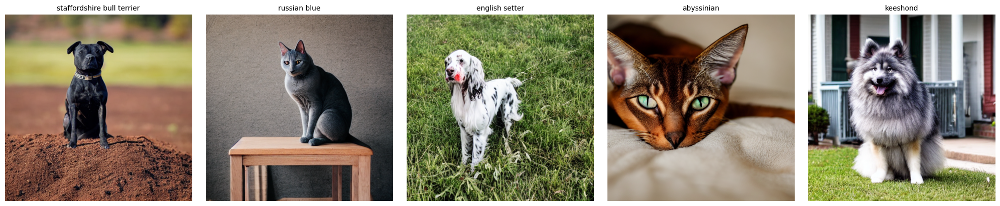

In [ ]:
def show_random_generated_images(output_dir, num_examples=4):
    """
    Shows random examples from a folder, if they exists, showing them in a single row.

    Parameters:

    output_dir (str): Path to the folder containing generated images.
    num_examples (int): Number of examples to show.
    """
    # 1. Trova tutti i file PNG (o JPG) nelle sottocartelle di output_dir
    image_paths = []
    for root, _, files in os.walk(output_dir):
        for fname in files:
            if fname.lower().endswith(('.png', '.jpg', '.jpeg')):
                image_paths.append(os.path.join(root, fname))

    if not image_paths:
        print(f"Nessuna immagine trovata in '{output_dir}'.")
        return

    # 2. Seleziona casualmente num_examples (senza ripetere)
    sample_paths = random.sample(image_paths, min(num_examples, len(image_paths)))

    # 3. Prepara la figura con tanti subplot orizzontali
    fig, axes = plt.subplots(
        ncols=len(sample_paths),
        figsize=(4 * len(sample_paths), 4),
        constrained_layout=True
    )

    # Se num_examples == 1, axes non è lista ma singolo Axes
    if len(sample_paths) == 1:
        axes = [axes]

    # 4. Carica e mostra ogni immagine
    for ax, img_path in zip(axes, sample_paths):
        img = Image.open(img_path)
        ax.imshow(img)
        ax.axis('off')  # rimuove assi e spine
        filename = os.path.basename(img_path)
        filename_cleaned = filename.split("_")[0]
        ax.set_title(filename_cleaned, fontsize=10)

    plt.show()


print("\nPrinting some generated images:")
show_random_generated_images(OUTPUT_DIR, num_examples=5)

# Generated images quality
- IS
- FID

Using device: cuda
Starting evaluation...
Loading Inception-v3 model...

Evaluating abyssinian vs Abyssinian...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.1814 ± 0.1416, FID: 139.3997

Evaluating bengal vs Bengal...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.2431 ± 0.0996, FID: 175.5951

Evaluating birman vs Birman...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.3974 ± 0.3002, FID: 208.2857

Evaluating bombay vs Bombay...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.2396 ± 0.2307, FID: 179.9972

Evaluating british shorthair vs British_Shorthair...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.2723 ± 0.2519, FID: 152.2566

Evaluating egyptian mau vs Egyptian_Mau...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.2047 ± 0.1622, FID: 122.2502

Evaluating maine coon vs Maine_Coon...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.2727 ± 0.2675, FID: 157.4927

Evaluating persian vs Persian...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.1289 ± 0.2275, FID: 82.2111

Evaluating ragdoll vs Ragdoll...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.4815 ± 0.1812, FID: 171.8526

Evaluating russian blue vs Russian_Blue...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.2685 ± 0.2258, FID: 131.6413

Evaluating siamese vs Siamese...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.2070 ± 0.2640, FID: 125.2927

Evaluating sphynx vs Sphynx...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.5428 ± 0.2750, FID: 184.9185

Evaluating american bulldog vs american_bulldog...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.2811 ± 0.1402, FID: 92.1863

Evaluating american pit bull terrier vs american_pit_bull_terrier...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.2963 ± 0.2459, FID: 133.2696

Evaluating basset hound vs basset_hound...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.1829 ± 0.2097, FID: 101.0613

Evaluating beagle vs beagle...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.2671 ± 0.2493, FID: 98.1280

Evaluating boxer vs boxer...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.2041 ± 0.2138, FID: 100.3096

Evaluating chihuahua vs chihuahua...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.0348 ± 0.0401, FID: 98.3497

Evaluating english cocker spaniel vs english_cocker_spaniel...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.4577 ± 0.1834, FID: 134.2275

Evaluating english setter vs english_setter...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.4325 ± 0.2514, FID: 122.5986

Evaluating german shorthaired vs german_shorthaired...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.4859 ± 0.3180, FID: 142.8460

Evaluating great pyrenees vs great_pyrenees...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.1319 ± 0.1815, FID: 63.1753

Evaluating havanese vs havanese...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.3237 ± 0.3332, FID: 133.2898

Evaluating japanese chin vs japanese_chin...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.1785 ± 0.2343, FID: 63.6826

Evaluating keeshond vs keeshond...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.2218 ± 0.2074, FID: 112.7202

Evaluating leonberger vs leonberger...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.2142 ± 0.1475, FID: 118.8264

Evaluating miniature pinscher vs miniature_pinscher...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.1705 ± 0.1553, FID: 115.7261

Evaluating newfoundland vs newfoundland...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.1162 ± 0.1065, FID: 98.8752

Evaluating pomeranian vs pomeranian...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.1397 ± 0.2560, FID: 79.4921

Evaluating pug vs pug...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.0284 ± 0.0276, FID: 81.7424

Evaluating saint bernard vs saint_bernard...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.1291 ± 0.2578, FID: 78.9045

Evaluating samoyed vs samoyed...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.0689 ± 0.1390, FID: 47.5418

Evaluating scottish terrier vs scottish_terrier...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.4198 ± 0.2370, FID: 157.3135

Evaluating shiba inu vs shiba_inu...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.4044 ± 0.2094, FID: 141.1527

Evaluating staffordshire bull terrier vs staffordshire_bull_terrier...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.4587 ± 0.1774, FID: 127.8603

Evaluating wheaten terrier vs wheaten_terrier...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.4624 ± 0.1643, FID: 147.8393

Evaluating yorkshire terrier vs yorkshire_terrier...


Gen:   0%|          | 0/20 [00:00<?, ?it/s]

Real:   0%|          | 0/20 [00:00<?, ?it/s]

IS: 1.0660 ± 0.0725, FID: 98.1039
Avg IS: 1.2599, Avg FID: 122.1734
Done.


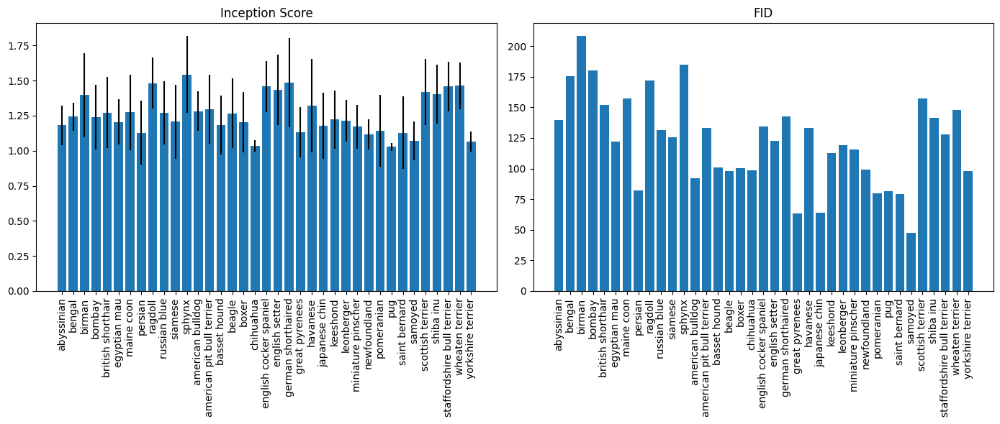

In [ ]:

# Set random seeds for reproducibility
SEED = 42
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
if torch.cuda.is_available():
    torch.cuda.manual_seed(SEED)

# Define paths
GEN_IMAGES_DIR = "generated_pet_images"
REAL_IMAGES_DIR = "./oxford_pet/oxford-iiit-pet"
RESULTS_DIR = "evaluation_results"
os.makedirs(RESULTS_DIR, exist_ok=True)

# Device configuration
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {DEVICE}")

# Load Inception model
def load_inception_model():
    """Load the pretrained Inception-v3 model."""
    try:
        model = torchvision.models.inception_v3(weights="IMAGENET1K_V1")
    except:
        model = torchvision.models.inception_v3(pretrained=True)
    model.eval()
    model.to(DEVICE)
    return model

# Define image preprocessing
def get_transforms():
    """Get transforms for image preprocessing."""
    return T.Compose([
        T.Resize((299, 299)),  # Inception v3 input size
        T.ToTensor(),
        T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])

# Map class names between generated folders and Oxford dataset
def get_class_mapping():
    """Map folder my generated names (lowercase with spaces) to Oxford images names (some lowercase, some Camelcase, with "_" instead of spaces)."""
    return {
        # Cats
        "abyssinian":             "Abyssinian",
        "bengal":                 "Bengal",
        "birman":                 "Birman",
        "bombay":                 "Bombay",
        "british shorthair":      "British_Shorthair",
        "egyptian mau":           "Egyptian_Mau",
        "maine coon":             "Maine_Coon",
        "persian":                "Persian",
        "ragdoll":                "Ragdoll",
        "russian blue":           "Russian_Blue",
        "siamese":                "Siamese",
        "sphynx":                 "Sphynx",
        # Dogs
        "american bulldog":           "american_bulldog",
        "american pit bull terrier":  "american_pit_bull_terrier",
        "basset hound":               "basset_hound",
        "beagle":                     "beagle",
        "boxer":                      "boxer",
        "chihuahua":                  "chihuahua",
        "english cocker spaniel":     "english_cocker_spaniel",
        "english setter":             "english_setter",
        "german shorthaired":         "german_shorthaired",
        "great pyrenees":             "great_pyrenees",
        "havanese":                   "havanese",
        "japanese chin":              "japanese_chin",
        "keeshond":                   "keeshond",
        "leonberger":                 "leonberger",
        "miniature pinscher":         "miniature_pinscher",
        "newfoundland":               "newfoundland",
        "pomeranian":                 "pomeranian",
        "pug":                        "pug",
        "saint bernard":              "saint_bernard",
        "samoyed":                    "samoyed",
        "scottish terrier":           "scottish_terrier",
        "shiba inu":                  "shiba_inu",
        "staffordshire bull terrier": "staffordshire_bull_terrier",
        "wheaten terrier":            "wheaten_terrier",
        "yorkshire terrier":          "yorkshire_terrier"
    }

# Load generated images
def load_images(directory, class_name, num_images=20, transform=None):
    """
    Load images from a generated folder (lowercase with spaces).

    Parameters:

    directory (str): Path to the folder containing generated images.
    class_name (str): Name of the class (lowercase with spaces).
    num_images (int): Number of images to load.
    transform (callable, optional): Transformations to apply to each image.

    Returns:

    List[torch.Tensor]: List of loaded images.

    """
    class_dir = os.path.join(directory, class_name)
    if not os.path.isdir(class_dir):
        print(f"Warning: Directory {class_dir} does not exist")
        return []
    files = [f for f in os.listdir(class_dir) if f.lower().endswith(('.jpg','.jpeg','.png'))]
    if not files:
        print(f"Warning: No image files found in {class_dir}")
        return []
    if len(files) > num_images:
        files = random.sample(files, num_images)
    imgs = []
    for fname in files:
        path = os.path.join(class_dir, fname)
        try:
            img = Image.open(path).convert('RGB')
            if transform:
                img = transform(img)
            imgs.append(img)
        except Exception as e:
            print(f"Error loading image {path}: {e}")
    return imgs

# Load real images from Oxford-IIIT Pet dataset
def load_real_pet_images(real_class, num_images=20, transform=None):
    """
    Load real images (Camel_Case prefix) from Oxford dataset.

    Parameters:

    real_class (str): Name of the class (Camel_Case).
    num_images (int): Number of images to load.
    transform (callable, optional): Transformations to apply to each image.

    Returns:

    List[torch.Tensor]: List of loaded images.
    """
    images_dir = os.path.join(REAL_IMAGES_DIR, "images")
    prefix = real_class + "_"
    all_files = [f for f in os.listdir(images_dir)
                 if f.startswith(prefix) and f.lower().endswith(('.jpg','.jpeg','.png'))]
    if not all_files:
        print(f"Warning: No image files found for class {real_class} in {images_dir}")
        return []
    if len(all_files) > num_images:
        all_files = random.sample(all_files, num_images)
    imgs = []
    for fname in all_files:
        path = os.path.join(images_dir, fname)
        try:
            img = Image.open(path).convert('RGB')
            if transform:
                img = transform(img)
            imgs.append(img)
        except Exception as e:
            print(f"Error loading image {path}: {e}")
    return imgs


# Extract features using Inception model
def extract_features(model, images):
    """
    Extract features from images using the Inception model.

    Parameters:

    model (torch.nn.Module): Inception model.
    images (List[torch.Tensor]): List of images.

    Returns:

    List[torch.Tensor]: List of extracted features.
    """
    feats = []
    with torch.no_grad():
        for img in images:
            inp = img.unsqueeze(0).to(DEVICE)
            feat = model(inp)
            feats.append(feat.cpu().numpy())
    return np.concatenate(feats) if feats else np.array([])

# Calculate Inception Score
def calculate_inception_score(probs, splits=10):
    """
    Calculate Inception Score.

    Parameters:

    probs (np.ndarray): Array of probabilities.
    splits (int): Number of splits.

    Returns:

    Tuple[float, float]: Mean and standard deviation of Inception scores.
    """
    scores = []
    N = probs.shape[0]
    split_size = N // splits
    for k in range(splits):
        part = probs[k*split_size:(k+1)*split_size]
        py = np.mean(part, axis=0)
        kl = part * (np.log(part+1e-10) - np.log(py+1e-10))
        scores.append(np.exp(np.mean(np.sum(kl, axis=1))))
    return np.mean(scores), np.std(scores)

# Calculate FID
def calculate_fid(mu1, sigma1, mu2, sigma2):
    """
    Calculate FID between two Gaussians.

    Parameters:

    mu1 (np.ndarray): Mean of the first Gaussian.
    sigma1 (np.ndarray): Covariance matrix of the first Gaussian
    mu2 (np.ndarray): Mean of the second Gaussian.
    sigma2 (np.ndarray): Covariance matrix of the second Gaussian.

    Returns:

    float: FID value.
    """
    diff = mu1 - mu2
    eps = 1e-6
    sigma1 += np.eye(sigma1.shape[0]) * eps
    sigma2 += np.eye(sigma2.shape[0]) * eps
    try:
        covmean = linalg.sqrtm(sigma1 @ sigma2)
        if np.iscomplexobj(covmean):
            covmean = covmean.real
        fid = np.sum(diff**2) + np.trace(sigma1 + sigma2 - 2*covmean)
    except Exception:
        fid = np.sum(diff**2) + np.trace(sigma1 + sigma2)
    return fid

# Main evaluation function
def evaluate_generated_images():
    print("Loading Inception-v3 model...")
    inception = load_inception_model()
    transform = get_transforms()
    mapping = get_class_mapping()

    is_scores = {}
    fid_scores = {}

    # Define feature extractor submodel
    class InceptionV3Features(torch.nn.Module):
        def __init__(self, base):
            super().__init__()
            self.base = base
            self.avgpool = base.avgpool
            self.fc = base.fc
        def forward(self, x):

            # forward up to Mixed_7c
            x = self.base.Conv2d_1a_3x3(x)
            x = self.base.Conv2d_2a_3x3(x)
            x = self.base.Conv2d_2b_3x3(x)
            x = self.base.maxpool1(x)
            x = self.base.Conv2d_3b_1x1(x)
            x = self.base.Conv2d_4a_3x3(x)
            x = self.base.maxpool2(x)
            x = self.base.Mixed_5b(x)
            x = self.base.Mixed_5c(x)
            x = self.base.Mixed_5d(x)
            x = self.base.Mixed_6a(x)
            x = self.base.Mixed_6b(x)
            x = self.base.Mixed_6c(x)
            x = self.base.Mixed_6d(x)
            x = self.base.Mixed_6e(x)
            x = self.base.Mixed_7a(x)
            x = self.base.Mixed_7b(x)
            x = self.base.Mixed_7c(x)
            pool = self.avgpool(x)
            pool = torch.flatten(pool, 1)
            logits = self.fc(pool)
            return logits, pool

    feat_model = InceptionV3Features(inception).to(DEVICE).eval()

    for gen_class, real_class in mapping.items():
        print(f"\nEvaluating {gen_class} vs {real_class}...")
        gen_imgs  = load_images(GEN_IMAGES_DIR, gen_class, transform=transform)
        real_imgs = load_real_pet_images(real_class, transform=transform)
        if not gen_imgs or not real_imgs:
            continue

        gen_preds, gen_feats, real_feats = [], [], []
        with torch.no_grad():
            for img in tqdm(gen_imgs, desc="Gen"    ):
                img = img.unsqueeze(0).to(DEVICE)
                logit, feat = feat_model(img)
                gen_preds.append(torch.nn.functional.softmax(logit, dim=1).cpu().numpy())
                gen_feats.append(feat.cpu().numpy().reshape(-1))
            for img in tqdm(real_imgs, desc="Real"):
                img = img.unsqueeze(0).to(DEVICE)
                _, feat = feat_model(img)
                real_feats.append(feat.cpu().numpy().reshape(-1))

        gen_preds = np.vstack(gen_preds)
        mu_gen, sigma_gen = np.mean(gen_feats, axis=0), np.cov(gen_feats, rowvar=False)
        mu_real, sigma_real = np.mean(real_feats, axis=0), np.cov(real_feats, rowvar=False)

        is_mean, is_std = calculate_inception_score(gen_preds)
        fid = calculate_fid(mu_gen, sigma_gen, mu_real, sigma_real)

        is_scores[gen_class] = (is_mean, is_std)
        fid_scores[gen_class] = fid
        print(f"IS: {is_mean:.4f} ± {is_std:.4f}, FID: {fid:.4f}")

    # Save and plot
    df = pd.DataFrame({
        'class': list(is_scores.keys()),
        'is_mean': [v[0] for v in is_scores.values()],
        'is_std':  [v[1] for v in is_scores.values()],
        'fid':     [fid_scores[k] for k in is_scores.keys()]
    })
    df.to_csv(os.path.join(RESULTS_DIR, 'evaluation_results.csv'), index=False)

    plt.figure(figsize=(14,6))
    # Inception Score
    plt.subplot(1,2,1)
    plt.bar(df['class'], df['is_mean'], yerr=df['is_std'])
    plt.xticks(rotation=90)
    plt.title('Inception Score')

    # FID
    plt.subplot(1,2,2)
    plt.bar(df['class'], df['fid'])
    plt.xticks(rotation=90)
    plt.title('FID')

    plt.tight_layout()
    plt.savefig(os.path.join(RESULTS_DIR, 'evaluation_plots.png'))

    print(f"Avg IS: {df['is_mean'].mean():.4f}, Avg FID: {df['fid'].mean():.4f}")
    return df

if __name__ == "__main__":
    print("Starting evaluation...")
    evaluate_generated_images()
    print("Done.")




- **Inception Score (IS):** IS is around 1, that implies that the generated samples are low quality
- **Fréchet Inception Distance (FID):** FID values above 100 reflects both lower realism and diversity in the generated images, comparing to the original one

My prediction is that adding those images to the original dataset could cause lower performance, let's find out!
<a name="gen-img-disc">

# Model training and evaluation
- a model with only original images
- a model with original images + generated images

In [ ]:
if do_train:
    # Data Augmentation and transformation
    # heavy for training set
    train_transform = T.Compose([
        T.Resize((224, 224)),
        T.RandomHorizontalFlip(p=0.5),
        T.RandomRotation(15),
        T.RandomApply([
            T.GaussianBlur(3, (0.5, 5))
        ], p=0.5),
        T.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
        T.ToTensor(),
        T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

    # lighter for validation / test set
    val_transform = T.Compose([
        T.Resize((224, 224)),
        T.ToTensor(),
        T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

    # Class for handling generated images
    class GeneratedPetDataset(Dataset):
        """
        Custom Dataset class to load generated pet images organized in subfolders by class.

        Parameters:

        root_dir (str): Path to the root directory containing class-named folders.
        transform (callable, optional): Transformations to apply to each image.
        """
        def __init__(self, root_dir, transform=None):
            self.root_dir = root_dir
            self.transform = transform
            self.classes = sorted([d for d in os.listdir(root_dir) if os.path.isdir(os.path.join(root_dir, d))])
            self.class_to_idx = {cls_name: i for i, cls_name in enumerate(self.classes)}

            self.samples = []
            for class_name in self.classes:
                class_dir = os.path.join(root_dir, class_name)
                class_idx = self.class_to_idx[class_name]

                for img_path in glob.glob(os.path.join(class_dir, "*.png")):
                    self.samples.append((img_path, class_idx))

        def __len__(self):
            return len(self.samples)

        def __getitem__(self, idx):
            img_path, class_idx = self.samples[idx]
            image = Image.open(img_path).convert('RGB')

            if self.transform:
                image = self.transform(image)

            return image, class_idx

    # Classe per applicare transform dopo lo split
    class TransformedSubset(torch.utils.data.Dataset):
        """
        Wrapper around a dataset subset to apply transforms dynamically after splitting.

        Parameters:
            subset (torch.utils.data.Subset): A subset of a dataset.
            transform (callable, optional): Transformations to apply to each image.
        """
        def __init__(self, subset, transform=None):
            self.subset = subset
            self.transform = transform

        def __getitem__(self, idx):
            x, y = self.subset[idx]
            if self.transform:
                x = self.transform(x)
            return x, y

        def __len__(self):
            return len(self.subset)

    class PetClassifier:
        """
        Class that encapsulates the full training and evaluation pipeline for pet classification.

        Parameters:
            model_name (str): Name identifier for the model and checkpoints.
            dataset_path (str): Path to the Oxford-IIIT Pet dataset.
            generated_images_path (str or None): Path to the generated pet images, if any.
            batch_size (int): Number of samples per batch.
            num_epochs (int): Maximum number of training epochs.
            patience (int): Early stopping patience based on validation loss.
            log_every_n_iter (int): Frequency of printing training logs.
            save_dir (str): Directory to save models and results.
        """
        def __init__(self,
                    model_name="effnetb0_pet",
                    dataset_path='./oxford_pet',
                    generated_images_path=None,
                    batch_size=32,
                    num_epochs=100,
                    patience=5,
                    log_every_n_iter=40,
                    save_dir='./models'):

            self.model_name = model_name
            self.dataset_path = dataset_path
            self.generated_images_path = generated_images_path
            self.batch_size = batch_size
            self.num_epochs = num_epochs
            self.patience = patience
            self.log_every_n_iter = log_every_n_iter
            self.save_dir = save_dir

            # Crea la directory per salvare i modelli se non esiste
            os.makedirs(save_dir, exist_ok=True)

            # Impostazioni del dispositivo
            self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
            print(f"Device: {self.device}")

            # Attributi che verranno inizializzati in seguito
            self.classes = None
            self.model = None
            self.train_loader = None
            self.val_loader = None
            self.test_loader = None
            self.criterion = nn.CrossEntropyLoss()
            self.results = {}

        def load_datasets(self):
            """
            Loads and prepares the training, validation, and test datasets.
            Optionally includes generated images in the training set.
            """
            # Carica il dataset originale Oxford-IIIT Pet senza trasformazioni
            trainval_dataset = datasets.OxfordIIITPet(
                root=self.dataset_path,
                split='trainval',
                download=True,
                transform=None
            )

            test_dataset = datasets.OxfordIIITPet(
                root=self.dataset_path,
                split='test',
                download=True,
                transform=val_transform
            )

            # Salva le classi
            self.classes = trainval_dataset.classes
            print(f"Classes in oxford dataset: {len(self.classes)}")

            # Crea split train/val per il dataset originale
            train_size = int(0.8 * len(trainval_dataset))
            val_size = len(trainval_dataset) - train_size
            train_indices = list(range(train_size))
            val_indices = list(range(train_size, len(trainval_dataset)))

            # Crea subset
            train_subset = Subset(trainval_dataset, train_indices)
            val_subset = Subset(trainval_dataset, val_indices)

            # Applica le trasformazioni
            train_dataset_orig = TransformedSubset(train_subset, transform=train_transform)
            val_dataset = TransformedSubset(val_subset, transform=val_transform)

            # Se ci sono immagini generate, aggiungerle al dataset di training
            if self.generated_images_path:
                try:
                    # Carica il dataset delle immagini generate
                    generated_dataset = GeneratedPetDataset(
                        root_dir=self.generated_images_path,
                        transform=None
                    )

                    print(f"Images generated loaded: {len(generated_dataset)}")

                    # Crea subset per le immagini generate (tutte per il training)
                    generated_indices = list(range(len(generated_dataset)))
                    generated_subset = Subset(generated_dataset, generated_indices)
                    generated_train_dataset = TransformedSubset(generated_subset, transform=train_transform)

                    # Concatena i dataset di training: originale + generato
                    train_dataset = ConcatDataset([train_dataset_orig, generated_train_dataset])
                    print(f"Original train dataset dimension: {len(train_dataset_orig)}")
                    print(f"Augmented train dataset dimension: {len(train_dataset)}")
                except Exception as e:
                    print(f"Error in loading generated images: {str(e)}")
                    print("Using only original dataset.")
                    train_dataset = train_dataset_orig
            else:
                train_dataset = train_dataset_orig
                print(f"train dataset dimension: {len(train_dataset)}")

            # Crea i data loader
            self.train_loader = DataLoader(train_dataset, batch_size=self.batch_size, shuffle=True)
            self.val_loader = DataLoader(val_dataset, batch_size=self.batch_size, shuffle=False)
            self.test_loader = DataLoader(test_dataset, batch_size=self.batch_size, shuffle=False)

        def create_model(self):
            """
            Initializes the EfficientNet-B0 model.
            """
            self.model = timm.create_model("efficientnet_b0", pretrained=True, num_classes=len(self.classes))
            self.model.to(self.device)

            # Ottimizzatore
            self.optimizer = optim.SGD(self.model.parameters(), lr=0.001)

            # Scheduler per ridurre il learning rate
            self.scheduler = ReduceLROnPlateau(self.optimizer, mode='min', patience=2, factor=0.1)

        def train(self):
            """
            Trains the model using early stopping on validation loss and saves the best model.
            """
            # Early stopping
            best_val_loss = float('inf')
            trigger_times = 0
            training_results = {
                'train_losses': [],
                'val_losses': [],
                'val_accuracies': [],
                'val_f1_scores': []
            }

            start_time = time.time()

            # Training loop
            for epoch in range(self.num_epochs):
                self.model.train()
                epoch_train_losses = []
                print(f"Epoch: {epoch}")

                for i, batch in enumerate(self.train_loader, 0):
                    x, targets = batch
                    x = x.to(self.device)
                    targets = targets.to(self.device)

                    self.optimizer.zero_grad()
                    logits = self.model(x)
                    loss = self.criterion(logits, targets)
                    loss.backward()
                    self.optimizer.step()

                    epoch_train_losses.append(loss.item())

                    if (i+1) % self.log_every_n_iter == 0:
                        avg_loss = sum(epoch_train_losses[-self.log_every_n_iter:]) / self.log_every_n_iter
                        print(f"> iter [{i+1}/{len(self.train_loader)}] - train_loss = {avg_loss:.4f}")

                # Mean loss of the epoch
                avg_epoch_loss = sum(epoch_train_losses) / len(epoch_train_losses)
                training_results['train_losses'].append(avg_epoch_loss)

                # Evaluation on validation set
                val_loss, val_accuracy, val_f1 = self.evaluate(self.val_loader)
                training_results['val_losses'].append(val_loss)
                training_results['val_accuracies'].append(val_accuracy)
                training_results['val_f1_scores'].append(val_f1)

                print("Validation report:")
                print(f"val loss = {val_loss:.4f} - val accuracy = {val_accuracy:.4f} - val F1 score = {val_f1:.4f}")

                # scheduler update
                self.scheduler.step(val_loss)

                # Early stopping
                if val_loss < best_val_loss:
                    best_val_loss = val_loss
                    trigger_times = 0
                    # Saving best model
                    model_path = os.path.join(self.save_dir, f"{self.model_name}.pth")
                    torch.save(self.model.state_dict(), model_path)
                    print(f"Model improved: saving checkpoint {model_path}")
                else:
                    trigger_times += 1
                    print(f"Trigger times: {trigger_times}/{self.patience}")
                    if trigger_times >= self.patience:
                        print("Early stopping triggered! Training interrupted.")
                        break

                # Savong each 10 epochs
                if epoch % 10 == 0:
                    checkpoint = {
                        'epoch': epoch,
                        'model_state_dict': self.model.state_dict(),
                        'optimizer_state_dict': self.optimizer.state_dict(),
                        'scheduler_state_dict': self.scheduler.state_dict(),
                        'val_loss': val_loss,
                        'val_accuracy': val_accuracy,
                        'val_f1': val_f1
                    }
                    checkpoint_path = os.path.join(self.save_dir, f'{self.model_name}_checkpoint_epoch_{epoch}.pth')
                    torch.save(checkpoint, checkpoint_path)
                    print(f"Checkpoint saved: {checkpoint_path}")

            training_time = time.time() - start_time
            print(f"Finished Training. Total time: {training_time:.2f} seconds")

            # Saving training results
            self.results['training'] = training_results
            self.results['training_time'] = training_time
            self.results['best_val_loss'] = best_val_loss

        def evaluate(self, data_loader):
            """Model evaluation on a data loader"""
            self.model.eval()
            losses = []
            total, correct = 0, 0
            all_targets = []
            all_preds = []

            with torch.no_grad():
                for batch in data_loader:
                    x, targets = batch
                    x = x.to(self.device)
                    targets = targets.to(self.device)
                    logits = self.model(x)
                    loss = self.criterion(logits, targets)
                    losses.append(loss.item())

                    # Predictions
                    _, preds = torch.max(logits, dim=1)
                    total += targets.size(0)
                    correct += (preds == targets).sum().item()

                    # Targets and predictions for F1 score
                    all_targets.extend(targets.cpu().numpy())
                    all_preds.extend(preds.cpu().numpy())

            avg_loss = sum(losses) / len(losses)
            accuracy = correct / total
            f1 = f1_score(all_targets, all_preds, average='macro')

            return avg_loss, accuracy, f1

        def plot_confusion_matrix(self, save_path=None):
            """
            Plot and optionally save the confusion matrix on the test set.

            Parameters:

            save_path (str): Path to save the plot image. If None, it shows the plot instead.
            """
            self.model.eval()
            y_true = []
            y_pred = []

            with torch.no_grad():
                for inputs, labels in self.test_loader:
                    inputs, labels = inputs.to(self.device), labels.to(self.device)
                    outputs = self.model(inputs)
                    _, predicted = torch.max(outputs, 1)

                    y_true.extend(labels.cpu().numpy())
                    y_pred.extend(predicted.cpu().numpy())

            cm = confusion_matrix(y_true, y_pred)
            plt.figure(figsize=(12, 10))
            sns.heatmap(cm, annot=True, fmt='d', xticklabels=self.classes, yticklabels=self.classes, cmap='Blues')
            plt.xlabel('Predicted Labels')
            plt.ylabel('True Labels')
            plt.title(f'Confusion Matrix - {self.model_name}')

            if save_path:
                plt.savefig(save_path)
                print(f"Confusion matrix saved to: {save_path}")
            else:
                plt.show()


        def test(self):
            """Evaluate model on test set"""
            test_loss, test_accuracy, test_f1 = self.evaluate(self.test_loader)

            print("\nTest set results:")
            print(f"test loss = {test_loss:.4f} - test accuracy = {test_accuracy:.4f} - test F1 score = {test_f1:.4f}")

            # Saving final results
            self.results['test'] = {
                'loss': test_loss,
                'accuracy': test_accuracy,
                'f1_score': test_f1
            }

            results_path = os.path.join(self.save_dir, f'{self.model_name}_results.json')
            with open(results_path, 'w') as f:
                json.dump(self.results, f, indent=4)
            print(f"Final results saved: {results_path}")

            conf_matrix_path = os.path.join(self.save_dir, f'{self.model_name}_confusion_matrix.png')
            self.plot_confusion_matrix(save_path=conf_matrix_path)

            return test_loss, test_accuracy, test_f1

        def save_model_info(self):
            """Saves  model informations and settings"""
            info = {
                'model_name': self.model_name,
                'dataset_path': self.dataset_path,
                'generated_images_path': self.generated_images_path,
                'batch_size': self.batch_size,
                'num_epochs': self.num_epochs,
                'patience': self.patience,
                'device': str(self.device),
                'date_created': datetime.now().strftime("%Y-%m-%d %H:%M:%S"),
                'num_classes': len(self.classes) if self.classes else None,
            }

            # Adding info to results dictionary
            self.results['info'] = info

        def run_pipeline(self):
            """Runs entire pipeline of trining and evaluation"""
            self.load_datasets()
            self.create_model()
            self.save_model_info()
            self.train()
            return self.test()

    def main():

        dataset_path = './oxford_pet'
        generated_images_path = './generated_pet_images'

        print("=" * 70)
        print("TRAINING STANDARD MODEL (without generated images)")
        print("=" * 70)

        # Model 1: Only dataset Oxford
        model_standard = PetClassifier(
            model_name="effnetb0_pet",
            dataset_path=dataset_path,
            generated_images_path=None,  # no added generating images
            batch_size=32,
            num_epochs=100,
            patience=5,
            save_dir='./models/standard'
        )

        standard_results = model_standard.run_pipeline()

        print("\n" + "=" * 70)
        print("TRAINING AUGMENTED MODEL (with generated images)")
        print("=" * 70)

        # Model 2: Dataset Oxford + generated images
        model_augmented = PetClassifier(
            model_name="effnetb0_pet_augmented",
            dataset_path=dataset_path,
            generated_images_path=generated_images_path,
            batch_size=32,
            num_epochs=100,
            patience=5,
            save_dir='./models/augmented'
        )

        augmented_results = model_augmented.run_pipeline()

        # Results comparison
        print("\n" + "=" * 70)
        print("RESULTS COMPARISON")
        print("=" * 70)
        print(f"Standard Model - Accuracy: {standard_results[1]:.4f}, F1 Score: {standard_results[2]:.4f}")
        print(f"Augmented Model - Accuracy: {augmented_results[1]:.4f}, F1 Score: {augmented_results[2]:.4f}")

        # Saving comparison in a JSON file
        comparison = {
            'standard_model': {
                'accuracy': standard_results[1],
                'f1_score': standard_results[2],
                'loss': standard_results[0]
            },
            'augmented_model': {
                'accuracy': augmented_results[1],
                'f1_score': augmented_results[2],
                'loss': augmented_results[0]
            }
        }

        with open('./models/model_comparison.json', 'w') as f:
            json.dump(comparison, f, indent=4)
        print("Confronto salvato in: ./models/model_comparison.json")



    if __name__ == "__main__":
        main()
else:
    print("models already trained!")

models already trained!


Both models are very similar in performance (that's probably due to the fact that, for computational issues, I added only 20 images per class), but it seems that the original model has better performances, as I was predicting before [here](#gen-img-disc),  so I'm using that

In [ ]:
def load_model_via_state_dict(weights_path, num_classes, device):
    """
    Recreates the architecture and loads state_dict.

    Parameters:

    weights_path (str): Path to the state_dict file.
    num_classes (int): Number of classes in the dataset.
    device (torch.device):
    """
    # 1. Instantiate the same model class
    model = create_model("efficientnet_b0", pretrained=False, num_classes=num_classes)
    # 2. Load the weights
    sd = torch.load(weights_path, map_location=device)
    model.load_state_dict(sd)
    model.to(device).eval()
    return model

In [ ]:
model = load_model_via_state_dict("models/standard/effnetb0_pet.pth", 37, device)

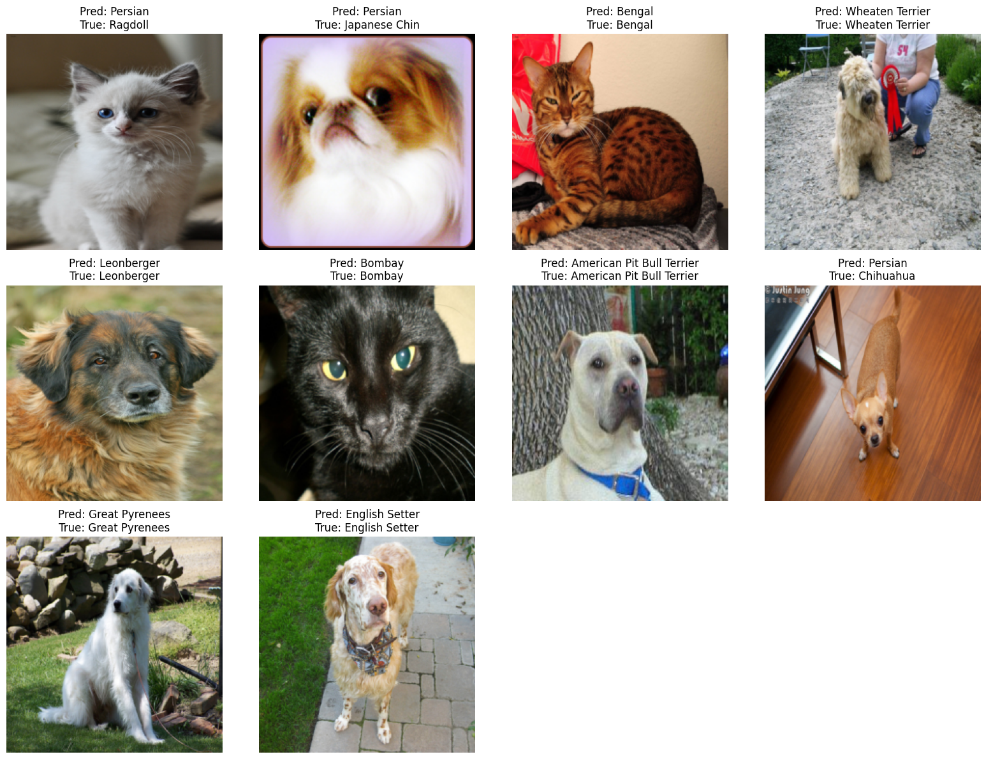

In [ ]:
def plot_random_images(
    model: torch.nn.Module,
    dataset,
    device: torch.device,
    classes: list,
    num_images: int = 10
):
    """
    Plot a grid of random samples from `dataset` with predicted vs true labels.

    Parameters:
    - model : PyTorch model in evaluation mode.
    - dataset: Dataset returning (img_tensor, label).
    - device: 'cpu' or 'cuda'.
    - classes: list of class-name strings, indexed by label.
    - num_images: maximum number of images to display.
    """
    model.to(device).eval()
    indices = random.sample(range(len(dataset)), num_images)

    images, true_labels, pred_labels = [], [], []
    with torch.no_grad():
        for idx in indices:
            img, true_label = dataset[idx]
            images.append(img)              # img in [0,1]
            true_labels.append(true_label)

            inp = img.unsqueeze(0).to(device)
            logits = model(inp)
            pred = torch.argmax(logits, dim=1).item()
            pred_labels.append(pred)

    # Grid layout
    ncols = int(math.ceil(math.sqrt(num_images)))
    nrows = int(math.ceil(num_images / ncols))
    fig, axes = plt.subplots(nrows, ncols, figsize=(4*ncols, 4*nrows))
    axes = axes.flatten() if num_images > 1 else [axes]

    for i, ax in enumerate(axes[:num_images]):
        arr = images[i].permute(1,2,0).cpu().numpy().clip(0,1)
        ax.imshow(arr)
        ax.set_title(f"Pred: {classes[pred_labels[i]]}\nTrue: {classes[true_labels[i]]}")
        ax.axis('off')

    # Turn off extras
    for ax in axes[num_images:]:
        ax.axis('off')

    plt.tight_layout()
    plt.show()

# plot 10 random predicted test set images
plot_random_images(model, test_dataset, device, classes, 10)

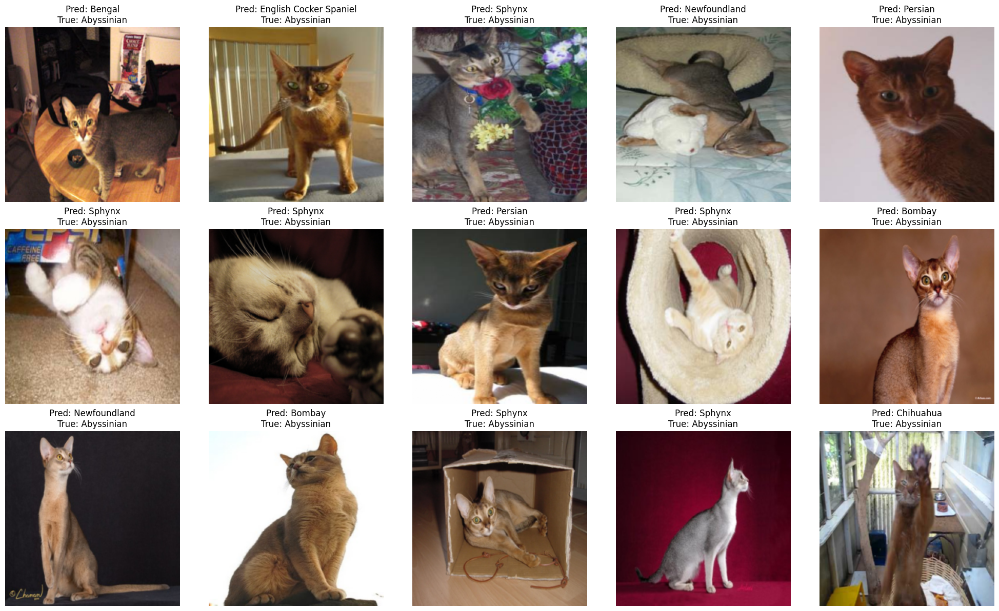

In [ ]:
import torch
import math
import matplotlib.pyplot as plt

def plot_wrong_images(
    model: torch.nn.Module,
    dataset,
    device: torch.device,
    classes: list,
    num_images: int = 10,
):
    """
    Display up to `num_images` images where the model's prediction was incorrect.
    Assumes dataset returns raw tensors in [0,1] with shape (C,H,W).

    Parameters:
    - model: PyTorch model in evaluation mode.
    - dataset: Dataset returning (img_tensor, label).
    - device: 'cpu' or 'cuda'.
    - classes: list of class-name strings, indexed by label.
    - num_images: maximum number of wrong images to display.
    """
    model.to(device).eval()

    wrong_images, true_labels, pred_labels = [], [], []
    with torch.no_grad():
        for img, true_label in dataset:
            inp = img.unsqueeze(0).to(device)
            logits = model(inp)
            pred = torch.argmax(logits, dim=1).item()

            if pred != true_label:
                wrong_images.append(img.cpu())
                true_labels.append(true_label)
                pred_labels.append(pred)

                if len(wrong_images) >= num_images:
                    break

    if not wrong_images:
        print("Nessuna previsione errata trovata nel dataset.")
        return

    # Grid size: fix 5 colonne
    n_cols = 5
    n_rows = math.ceil(len(wrong_images) / n_cols)
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(4 * n_cols, 4 * n_rows))
    axes = axes.flatten()

    for i, img in enumerate(wrong_images):
        # img: tensor in [0,1], shape (C,H,W)
        arr = img.permute(1, 2, 0).numpy().clip(0, 1)

        axes[i].imshow(arr)
        axes[i].set_title(
            f"Pred: {classes[pred_labels[i]]}\nTrue: {classes[true_labels[i]]}"
        )
        axes[i].axis('off')

    # Disattiva gli assi rimanenti
    for j in range(len(wrong_images), len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

plot_wrong_images(model, test_dataset, device, classes, 15)


# Breed prediction of the of the most beautiful dog in the world (my dog)

Top‐5 predictions:
  German Shorthaired   64.59%
  Staffordshire Bull Terrier 17.18%
  American Pit Bull Terrier 11.40%
  Basset Hound          1.14%
  Miniature Pinscher    1.13%


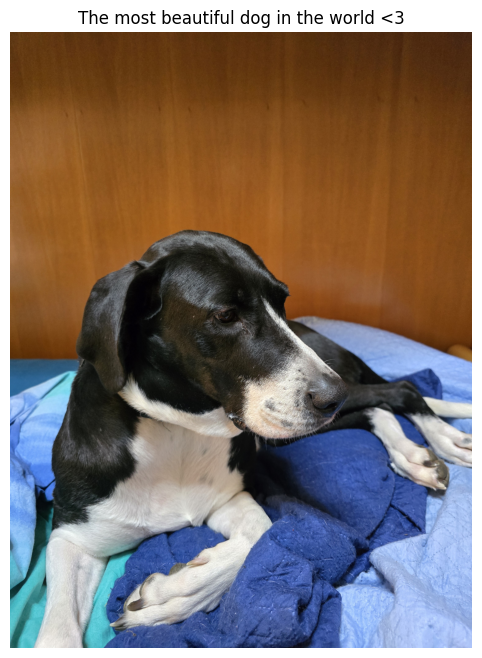

In [ ]:

def show_image_full_resolution(most_beautiful_dog_in_the_world: str,
                               model: torch.nn.Module,
                               orig_ds: datasets.OxfordIIITPet,
                               device: torch.device) -> None:
    """

    Load an image, run it through the model, and display it (in original quality) with top-5 predictions.

    Parameters:

    most_beautiful_dog_in_the_world (str): Path to the image file of the most beautiful dog in the world, no doubts about it :)
    model (torch.nn.Module): Trained classification model.
    orig_ds (datasets.OxfordIIITPet): Dataset instance to get class names.
    device (torch.device): Device to run inference on (e.g. 'cuda' or 'cpu').

    """
    # 1. Loading image and correcting EXIF orientation (to fix orientation issues)
    img = Image.open(most_beautiful_dog_in_the_world).convert('RGB')
    img = ImageOps.exif_transpose(img)

    # 2. Preprocessing
    preprocess = T.Compose([
        T.Resize((224, 224)),
        T.ToTensor(),
        T.Normalize(
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225]
        ),
    ])
    input_tensor = preprocess(img).unsqueeze(0).to(device)

    # 3. Inference
    model.eval()
    with torch.no_grad():
        logits = model(input_tensor)
        probs = torch.softmax(logits, dim=1)
        top5_prob, top5_idx = probs.topk(5, dim=1)
        top5_prob = top5_prob.cpu().squeeze(0).tolist()
        top5_idx = top5_idx.cpu().squeeze(0).tolist()

    # 4. Visualizing full resolution image
    plt.figure(figsize=(8, 8))
    plt.imshow(img)                 # using PIL image directly
    plt.axis('off')
    plt.title("The most beautiful dog in the world <3")

    # 5. Predictions
    print("Top‐5 predictions:")
    for prob, idx in zip(top5_prob, top5_idx):
        cls = orig_ds.classes[idx]
        print(f"  {cls:<20} {prob*100:5.2f}%")

    plt.show()


if __name__ == "__main__":
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    orig_ds = datasets.OxfordIIITPet(root="./oxford_pet", split="trainval", download=False)
    # Function call
    show_image_full_resolution("lola.jpg", model, orig_ds, device)


# Conclusion

It seems that adding more images made the performance of the efficientnetb0 model used to predict the Oxford-iit-pet dataset worse.  

This is probably due to the imperfect generation of stable diffusion v1.5 model used to generate images.  
Unfortunately, I don't have many computational resources, so I only added 20 more generated images for every class, which isn't much, maybe with 100 images for every class we would have seen an even worse performance, indicating that generating more images woth this model is not the correct way to go, or maybe the performances would have been better, but the FID score speak clearly: generated images are very different from original images.

My final raccomandation is to use the model trained without adding generated images, which performs very well given the fact that some pet breeds are very similar and mistakes made by this model are very reasonable, for example the best dog in the world (Lola) is a cross between a Great Dane (not in dataset) and a hunting dog, maybe even a German Shorthaired, and the model predicted its breed very well